In [1]:
import sys
import os
import torch
from torch.nn import CrossEntropyLoss, BCELoss, BCEWithLogitsLoss
from torch_geometric.data import DataLoader
# from torch_geometric.loader import DataLoader
import numpy as np
import os
import torch.nn.functional as F
import time
from torch_geometric.utils import subgraph, k_hop_subgraph
import math
from torch_geometric.utils.convert import to_networkx
import networkx as nx
from sklearn.metrics import f1_score,precision_score, recall_score

# import type of the models
sys.path.append('/home/hchen/PycharmProjects/ICDE23/GNNquery/SkylineGNN_py/validation')
sys.path.append('/home/hchen/PycharmProjects/ICDE23/GNNquery/SkylineGNN_py/utilities')


from drawRawGraphs import draw_graph_with_DataObj
from model import GraphEncoder
from readData import LoadData, LoadGraph
from MultiCostNetworks import MultiCostNetworks
from readCheckPoints import getMaxCheckPointName

In [3]:
print(torch.__version__)
print(torch.version.cuda)

1.11.0
None


In [4]:
path = "/home/hchen/IntelliJProjects/java_SkylineGNN/Data/C9_NY/C9_NY_NONE/C9_NY_NONE_5K"
train_paths_folder = "/home/hchen/IntelliJProjects/java_SkylineGNN/Data/results_bbs/C9_NY/C9_NY_NONE_5K_1200"
data_folder = "/home/hchen/IntelliJProjects/java_SkylineGNN/Data/C9_NY/C9_NY_NONE/C9_NY_NONE_5K"
save_folder = "/home/hchen/PycharmProjects/ICDE23/GNNquery/Data/mapped/C9_NY/C9_NY_NONE_5K"
checkpoint_folder = '/home/hchen/PycharmProjects/ICDE23/GNNquery/SkylineGNN_py/checkpoints/'
check_point_file = checkpoint_folder + '128_64_16_0_1_EmbedTrue_5000_train_checkpoint_Transformer_ConLossTrue_2GNN3FF_10k_train_samples.pt'

print(path)
print(train_paths_folder)
print(check_point_file)
print(data_folder)

/home/hchen/IntelliJProjects/java_SkylineGNN/Data/C9_NY/C9_NY_NONE/C9_NY_NONE_5K
/home/hchen/IntelliJProjects/java_SkylineGNN/Data/results_bbs/C9_NY/C9_NY_NONE_5K_1200
/home/hchen/PycharmProjects/ICDE23/GNNquery/SkylineGNN_py/checkpoints/128_64_16_0_1_EmbedTrue_5000_train_checkpoint_Transformer_ConLossTrue_2GNN3FF_10k_train_samples.pt
/home/hchen/IntelliJProjects/java_SkylineGNN/Data/C9_NY/C9_NY_NONE/C9_NY_NONE_5K


In [5]:
model_name = "Transformer"
n_nodes = 5000
embedding_dim = 128
hidden_dim = 64

# Parameters
node_dim = 2
edge_dim = 3
batch_size = 16
enable_embed = True
output_dim = 3
heads = 1
conn_loss_enable = True
enable_edge_attr = True

device = torch.device('cpu')
print(device)

cpu


In [10]:
# print('Using GPU, %i devices.' % torch.cuda.device_count())

# from pynvml import *
# nvmlInit()
# h = nvmlDeviceGetHandleByIndex(0)
# info = nvmlDeviceGetMemoryInfo(h)
# print(f'total    : {info.total}')
# print(f'free     : {info.free}')
# print(f'used     : {info.used}')

In [6]:
# load dataloader
num_node, graph = LoadGraph(
    path, logger=None, normalization_node=True, normalization_edge=True)
graph_size = num_node
print("==========================================")
train_dataset = MultiCostNetworks(graph, train_paths_folder=train_paths_folder, root=data_folder, split='train')
test_dataset = MultiCostNetworks(graph, train_paths_folder=train_paths_folder, root=data_folder, split='test')
train_loader = DataLoader(train_dataset, drop_last=True, batch_size=batch_size)
test_loader = DataLoader(test_dataset, drop_last=True, batch_size=batch_size)
# sys.exit(0)

/home/hchen/anaconda3/envs/GNNquery/lib/python3.9/site-packages/torch_geometric/deprecation.py:12: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


In [7]:
# initialize model
model = GraphEncoder(node_dim, edge_dim, embedding_dim, hidden_dim, output_num_class=output_dim, device=device, enable_embedding=enable_embed,
                     batch=batch_size, model_name=model_name, heads=heads).to(device)
optimizer = torch.optim.Adam(params=model.parameters(), lr=0.0001)

checkpoint = torch.load(check_point_file, map_location=torch.device('cpu'))
model.load_state_dict(checkpoint['model_state_dict'])
resume_epoch = checkpoint['epoch']
loss = checkpoint['loss']

Transformer model, edge dim:3 with multi-heads attention 1
Transformer model, edge dim:3 with multi-heads attention 1
Finish model initialization !!!!


In [8]:
# test function
@torch.no_grad()
def test(data):
    model.eval()

    total_loss = 0
    total_pre_n = 0
    total_n = 0
    total_graphs = 0
    total_conn_lost = 0
    total_nll_lost = 0

    data = data
    logits = model(data, n_nodes)

    loss = F.nll_loss(logits, data.y)
    total_nll_lost += loss.item() * data.num_graphs

    if conn_loss_enable:
        c_loss = (1/graph_size) * \
            (-math.log(model.connectivity_loss(logits, data)))
        total_conn_lost += c_loss * data.num_graphs
        loss = loss+c_loss

    total_pre_n += (np.argmax(logits.cpu().detach().numpy(), axis=1) == 1).sum() + (
        np.argmax(logits.cpu().detach().numpy(), axis=1) == 2).sum()
    total_n += ((data.y.cpu().detach().numpy() == 1).sum())

    total_graphs += data.num_graphs

    total_loss += loss.item() * data.num_graphs
    print(data.num_graphs, total_n, total_pre_n)

    # if n!=0:
    #     print(count, np.argmax(logits.cpu().numpy(),axis=1), n )
    #     sys.exit()

    return total_loss / data.num_graphs, total_nll_lost/data.num_graphs, total_conn_lost/data.num_graphs, total_pre_n / total_graphs, total_n / total_graphs, logits


In [9]:
n = graph_size
print(graph)
n_graph = to_networkx(graph, to_undirected=True, remove_self_loops=False)

count = 0
exit_loop = True

for index, test_data in enumerate(test_loader):
    if exit_loop:
        break
    start_time = time.time()
    val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, logits = test(
        test_data)
    end_time = time.time()
    print("{}, Val:{:.4f}({:.5f}+{:.5f})[{:.5f} - {:.5f}], running time each epoch:{:.2f}".format(
        index, val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, (end_time - start_time)))
    model_exectue_time = end_time - start_time


    start_time = time.time()
    predictions = np.argmax(
        logits[i*n:(i+1)*n, :].cpu().detach().numpy(), axis=1)
    data_y = test_data.y.cpu().detach().numpy()[i*n:(i+1)*n]
    pre_n_i = (predictions == 1).sum() + (predictions == 2).sum()
    total_n_i = (data_y == 1).sum()+(data_y == 2).sum()
    src = test_data.src_node_idx[i].item()
    dest = test_data.dest_node_idx[i].item()
    # Find connected sub_grap
    target_node_list = np.where(predictions == 1)[0].tolist()
    sub_node_set = set()
    for idx, node in enumerate(target_node_list):
        s_path = nx.dijkstra_path(n_graph, node, src)
        d_path = nx.dijkstra_path(n_graph, node, dest)
        # print(idx, ":", node, len(s_path), len(d_path))
        sub_node_set.update(s_path)
        sub_node_set.update(d_path)
    sub_node_set.add(src)
    sub_node_set.add(dest)
    end_time = time.time()
    sub_graph_finding_time = end_time-start_time

    m_data_y = np.zeros(n, dtype=bool)
    m_data_y[np.nonzero(data_y)] = True
    m_predict_y = np.zeros(n, dtype=bool)
    m_predict_y[np.nonzero(predictions)] = True
    m_sub_predict_y = np.zeros(n, dtype=bool)
    m_sub_predict_y[list(sub_node_set)] = True

    f1_score_1 = f1_score(m_data_y, m_predict_y)
    f1_score_2 = f1_score(data_y, predictions, average='micro')
    f1_score_3 = f1_score(data_y, predictions, average='macro')
    # f1_score_4 = f1_score(data_y, predictions, average='none')
    f1_score_1_s = f1_score(m_data_y, m_sub_predict_y)

    pre_score = precision_score(m_data_y, m_predict_y)
    pre_score_s = precision_score(m_data_y, m_sub_predict_y)

    rec_score = recall_score(m_data_y, m_predict_y)
    rec_score_s = recall_score(m_data_y, m_sub_predict_y)

    print("{}  {}-{}: {}->{} {} / {} ===== {}, sub_graph size : {}, time spend {:.6f} f1:{:.6f},f1_sub:{:.6f}, f1_micro:{:.6f}, f1_macro:{:.6f}, pre:{:.4f}, pre_sub:{:.4f}, recall:{:.4f}, recall_sub:{:.4f}"
    .format(count, index, i,src, dest, pre_n_i, total_n_i, float(pre_n_i/total_n_i), len(sub_node_set), sub_graph_finding_time+model_exectue_time,
    f1_score_1, f1_score_1_s, f1_score_2, f1_score_3,pre_score,pre_score_s,rec_score,rec_score_s))

    draw_graph_with_DataObj(graph, data_y, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item())
    draw_graph_with_DataObj(graph, predictions, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item())

Data(x=[5000, 2], edge_index=[2, 12046], edge_attr=[12046, 3])


0
DataBatch(x=[80000, 2], edge_index=[2, 192736], edge_attr=[192736, 3], y=[80000], src_node_idx=[16], dest_node_idx=[16], batch=[80000], ptr=[17])
Data(x=[5000, 2], edge_index=[2, 12046], edge_attr=[12046, 3])
16 1972 163
Val:1.0240(1.01708+0.00691)[10.18750 - 123.25000], running time each epoch:0.22
5 / 258 ===== overall:10.1875 / 123.25 in 0.21909451484680176 second
(5000,)
[0.38241469 0.38533174 0.38824472 ... 0.94072727 0.95881544 0.91956745]
[0.66234119 0.65592514 0.65014736 ... 0.54248972 0.59492821 0.5670994 ]
12046
12046
There are 12046 edges in the graph. 
2  nodes 2978 935
1000 -------------
2000 -------------
3000 -------------
4000 -------------
5000 -------------
6000 -------------
7000 -------------
8000 -------------
9000 -------------
10000 -------------
11000 -------------
12000 -------------


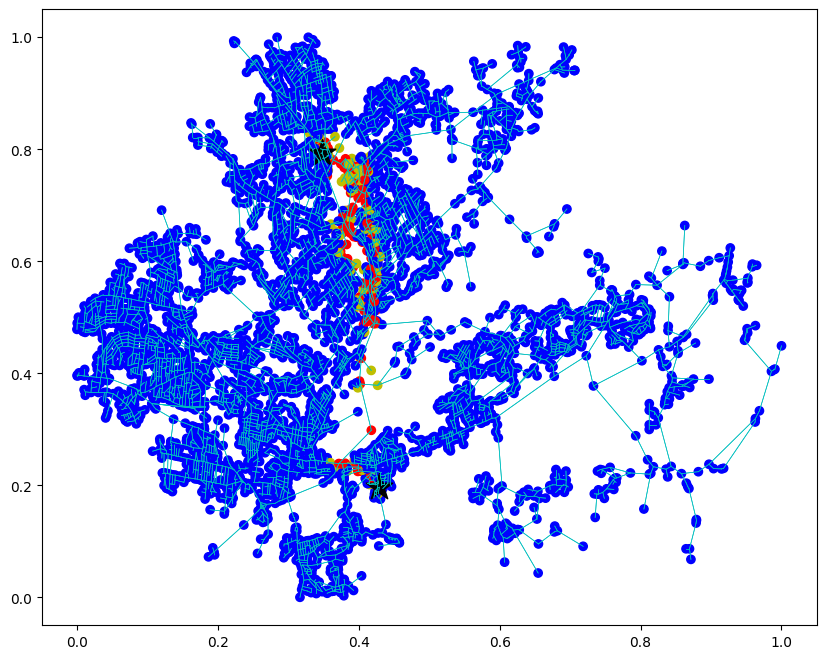

(5000,)
[0.38241469 0.38533174 0.38824472 ... 0.94072727 0.95881544 0.91956745]
[0.66234119 0.65592514 0.65014736 ... 0.54248972 0.59492821 0.5670994 ]
12046
12046
There are 12046 edges in the graph. 
2  nodes 2978 935
1000 -------------
2000 -------------
3000 -------------
4000 -------------
5000 -------------
6000 -------------
7000 -------------
8000 -------------
9000 -------------
10000 -------------
11000 -------------
12000 -------------


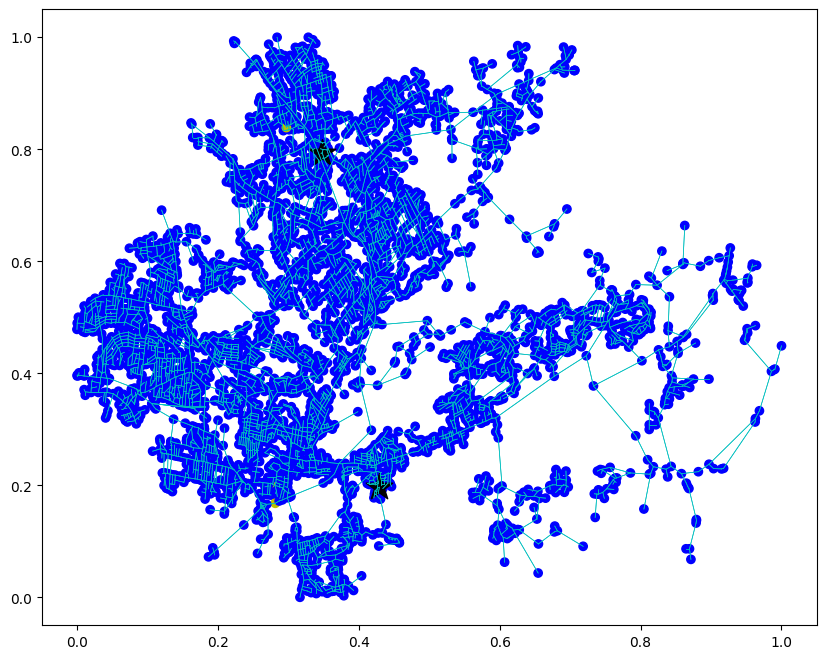

In [13]:
batch_num = 1
i = 1
n = num_node
grahp_size = num_node

for index, data in enumerate(test_loader):
    print(index)
    if index == batch_num:
      test_data = data
      break

print(test_data)
print(graph)

start_time = time.time()
val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, logits = test(test_data)
end_time = time.time()
print("Val:{:.4f}({:.5f}+{:.5f})[{:.5f} - {:.5f}], running time each epoch:{:.2f}".format(
            val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, (end_time - start_time)))

predictions = np.argmax(logits[i*n:(i+1)*n, :].cpu().detach().numpy(), axis=1)
data_y = data.y.cpu().detach().numpy()[i*n:(i+1)*n]
pre_n_i = (predictions == 1).sum() + (predictions == 2).sum()
total_n_i = (data_y == 1).sum()+(data_y == 2).sum()

print("{} / {} ===== overall:{} / {} in {} second".format(pre_n_i, total_n_i, test_p_n, test_n, end_time - start_time))


draw_graph_with_DataObj(graph, data_y, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item())
draw_graph_with_DataObj(graph, predictions, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item())

Batch(x=[185184, 2], edge_index=[2, 385536], edge_attr=[385536, 3], y=[185184], src_node_idx=[32], dest_node_idx=[32], batch=[185184], ptr=[33])
Batch(x=[185184, 2], edge_index=[2, 385536], edge_attr=[385536, 3], y=[185184], src_node_idx=[32], dest_node_idx=[32], batch=[185184], ptr=[33])
5787
Linear(in_features=2, out_features=256, bias=True) SAGEConv(256, 256) SAGEConv(256, 256)
torch.Size([185184, 256]) torch.Size([2, 385536])
32 7234 5618
Val:0.0747(0.07467+0.00000)[175.56250 - 226.06250], running time each epoch:6.05
121 / 141 ===== overall:175.5625 / 226.0625 in 6.054431438446045 second
(5787,)
[0.81934833 0.8180258  0.43024766 ... 0.17702593 0.17622481 0.16577232]
[0.80748    0.8079052  0.73786745 ... 0.41787786 0.4201064  0.49232516]
12048
12048
There are 12048 edges in the graph. 
2  nodes 4615 1264
1000 -------------
2000 -------------
3000 -------------
4000 -------------
5000 -------------
6000 -------------
7000 -------------
8000 -------------
9000 -------------
10000 ---

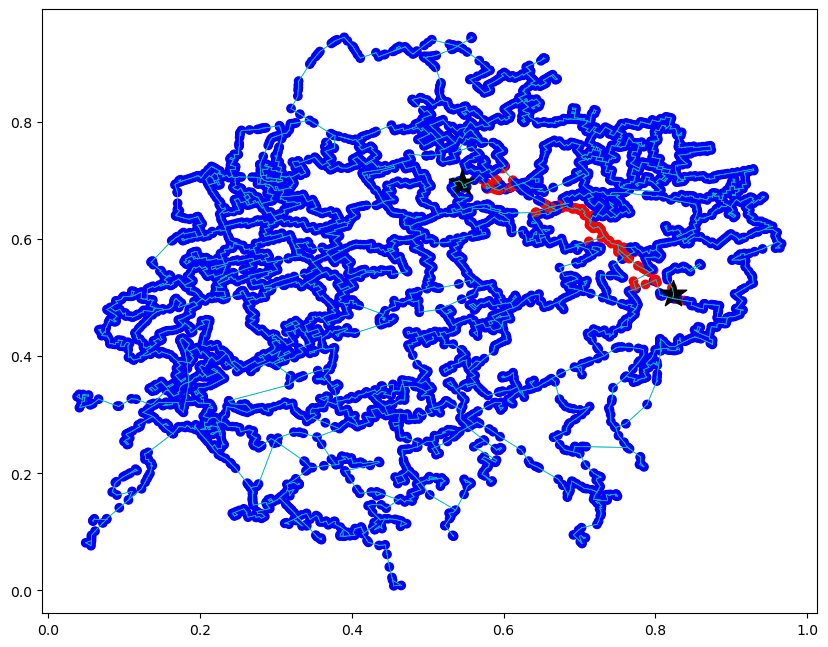

In [16]:
batch_num = 1
i = 10
n = num_node
grahp_size = num_node
test_data = None

for index, data in enumerate(test_loader):
#     print(index)
    if index == batch_num:
      test_data = data
      break

print(test_data)

start_time = time.time()
val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, logits = test(test_data)
end_time = time.time()
print("Val:{:.4f}({:.5f}+{:.5f})[{:.5f} - {:.5f}], running time each epoch:{:.2f}".format(
            val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, (end_time - start_time)))

# i = 16
# n = graph_size
# graph = test_data.to_data_list()[i]
# print(graph)

predictions = np.argmax(logits[i*n:(i+1)*n, :].cpu().detach().numpy(), axis=1)
data_y = data.y.cpu().detach().numpy()[i*n:(i+1)*n]
pre_n_i = (predictions == 1).sum() + (predictions == 2).sum()
total_n_i = (data_y == 1).sum()+(data_y == 2).sum()

print("{} / {} ===== overall:{} / {} in {} second".format(pre_n_i, total_n_i, test_p_n, test_n, end_time - start_time))


# draw_graph_with_DataObj(graph, data_y, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item())
draw_graph_with_DataObj(graph, predictions, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item())

Batch(x=[185184, 2], edge_index=[2, 385536], edge_attr=[385536, 3], y=[185184], src_node_idx=[32], dest_node_idx=[32], batch=[185184], ptr=[33])
Batch(x=[185184, 2], edge_index=[2, 385536], edge_attr=[385536, 3], y=[185184], src_node_idx=[32], dest_node_idx=[32], batch=[185184], ptr=[33])
5787
Linear(in_features=2, out_features=256, bias=True) SAGEConv(256, 256) SAGEConv(256, 256)
torch.Size([185184, 256]) torch.Size([2, 385536])
32 6866 4832
Val:0.0658(0.06575+0.00000)[151.00000 - 214.56250], running time each epoch:5.77
90 / 178 ===== overall:151.0 / 214.5625 in 5.766648530960083 second
(5787,)
[0.81934833 0.8180258  0.43024766 ... 0.17702593 0.17622481 0.16577232]
[0.80748    0.8079052  0.73786745 ... 0.41787786 0.4201064  0.49232516]
12048
12048
There are 12048 edges in the graph. 
2  nodes 5214 1478
1000 -------------
2000 -------------
3000 -------------
4000 -------------
5000 -------------
6000 -------------
7000 -------------
8000 -------------
9000 -------------
10000 -------

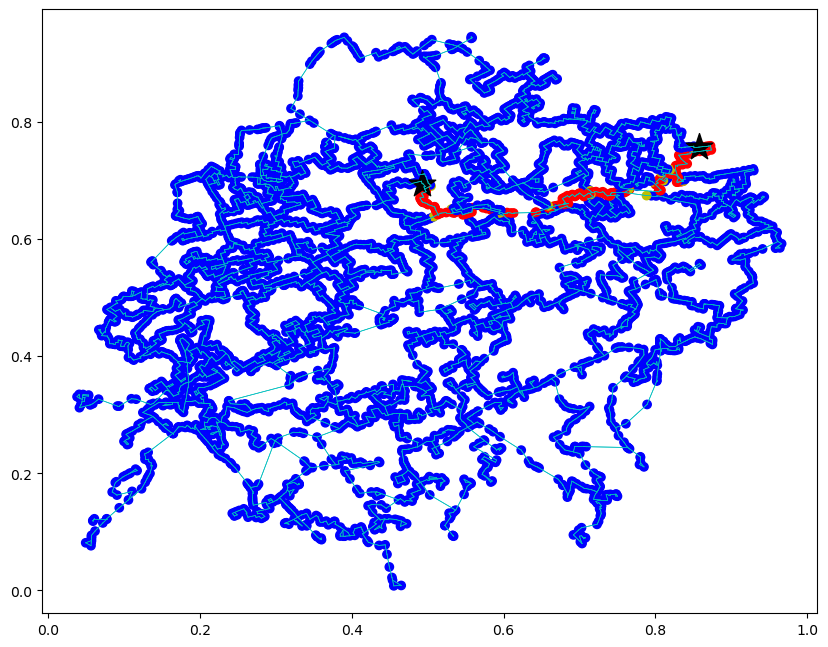

(5787,)
[0.81934833 0.8180258  0.43024766 ... 0.17702593 0.17622481 0.16577232]
[0.80748    0.8079052  0.73786745 ... 0.41787786 0.4201064  0.49232516]
12048
12048
There are 12048 edges in the graph. 
2  nodes 5214 1478
1000 -------------
2000 -------------
3000 -------------
4000 -------------
5000 -------------
6000 -------------
7000 -------------
8000 -------------
9000 -------------
10000 -------------
11000 -------------
12000 -------------


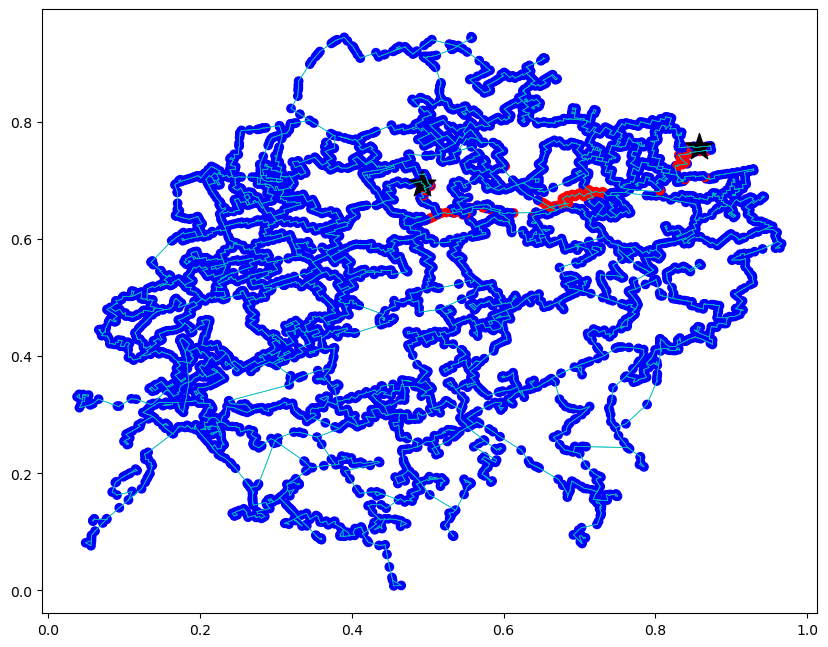

In [17]:
batch_num = 0
i = 24
n = num_node
grahp_size = num_node
test_data = None

for index, data in enumerate(test_loader):
#     print(index)
    if index == batch_num:
      test_data = data
      break

print(test_data)

start_time = time.time()
val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, logits = test(test_data)
end_time = time.time()
print("Val:{:.4f}({:.5f}+{:.5f})[{:.5f} - {:.5f}], running time each epoch:{:.2f}".format(
            val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, (end_time - start_time)))

# i = 16
# n = graph_size
# graph = test_data.to_data_list()[i]
# print(graph)

predictions = np.argmax(logits[i*n:(i+1)*n, :].cpu().detach().numpy(), axis=1)
data_y = data.y.cpu().detach().numpy()[i*n:(i+1)*n]
pre_n_i = (predictions == 1).sum() + (predictions == 2).sum()
total_n_i = (data_y == 1).sum()+(data_y == 2).sum()

print("{} / {} ===== overall:{} / {} in {} second".format(pre_n_i, total_n_i, test_p_n, test_n, end_time - start_time))


draw_graph_with_DataObj(graph, data_y, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item())
draw_graph_with_DataObj(graph, predictions, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item())

Batch(x=[185184, 2], edge_index=[2, 385536], edge_attr=[385536, 3], y=[185184], src_node_idx=[32], dest_node_idx=[32], batch=[185184], ptr=[33])
Batch(x=[185184, 2], edge_index=[2, 385536], edge_attr=[385536, 3], y=[185184], src_node_idx=[32], dest_node_idx=[32], batch=[185184], ptr=[33])
5787
Linear(in_features=2, out_features=256, bias=True) SAGEConv(256, 256) SAGEConv(256, 256)
torch.Size([185184, 256]) torch.Size([2, 385536])
32 6866 4842
Val:0.0655(0.06552+0.00000)[151.31250 - 214.56250], running time each epoch:5.51
19 / 82 ===== overall:151.3125 / 214.5625 in 5.513679504394531 second
(5787,)
[0.81934833 0.8180258  0.43024766 ... 0.17702593 0.17622481 0.16577232]
[0.80748    0.8079052  0.73786745 ... 0.41787786 0.4201064  0.49232516]
12048
12048
There are 12048 edges in the graph. 
2  nodes 5614 5348
1000 -------------
2000 -------------
3000 -------------
4000 -------------
5000 -------------
6000 -------------
7000 -------------
8000 -------------
9000 -------------
10000 -----

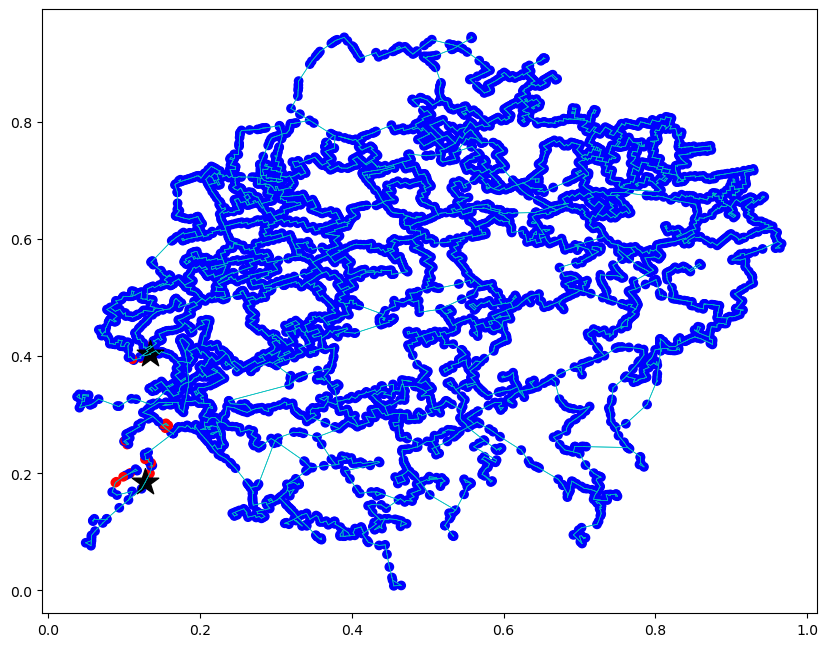

In [18]:
batch_num = 0
i = 31
n = num_node
grahp_size = num_node
test_data = None

for index, data in enumerate(test_loader):
#     print(index)
    if index == batch_num:
      test_data = data
      break

print(test_data)

start_time = time.time()
val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, logits = test(test_data)
end_time = time.time()
print("Val:{:.4f}({:.5f}+{:.5f})[{:.5f} - {:.5f}], running time each epoch:{:.2f}".format(
            val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, (end_time - start_time)))

# i = 16
# n = graph_size
# graph = test_data.to_data_list()[i]
# print(graph)

predictions = np.argmax(logits[i*n:(i+1)*n, :].cpu().detach().numpy(), axis=1)
data_y = data.y.cpu().detach().numpy()[i*n:(i+1)*n]
pre_n_i = (predictions == 1).sum() + (predictions == 2).sum()
total_n_i = (data_y == 1).sum()+(data_y == 2).sum()

print("{} / {} ===== overall:{} / {} in {} second".format(pre_n_i, total_n_i, test_p_n, test_n, end_time - start_time))


# draw_graph_with_DataObj(graph, data_y, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item())
draw_graph_with_DataObj(graph, predictions, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item())

In [19]:
org_path = "/home/gqxwolf/mydata/projectData/skylineGNN/dataset/C9_NY_NONE/C9_NY_NONE_30K"
org_train_paths_folder = "/home/gqxwolf/mydata/projectData/skylineGNN/results_back/C9_NY_NONE_30K/results"
org_data_folder = "/home/gqxwolf/mydata/projectData/skylineGNN/processed/C9_NY_NONE_30K/1"
# check_point_file = '/home/gqxwolf/mydata/projectData/skylineGNN/models/C9_NY_NONE_30K/GCN_models/1/256_256_32_1000_1_EmbedTrue_30000_train_checkpoint_SAGE_ConLossTrue_2GNN3FF_10k_train_samples.pt'

print(org_path)
print(org_train_paths_folder)
print(org_data_folder)
# print(check_point_file)

/home/gqxwolf/mydata/projectData/skylineGNN/dataset/C9_NY_NONE/C9_NY_NONE_30K
/home/gqxwolf/mydata/projectData/skylineGNN/results_back/C9_NY_NONE_30K/results
/home/gqxwolf/mydata/projectData/skylineGNN/processed/C9_NY_NONE_30K/1


In [20]:
org_num_node, org_graph = LoadGraph(org_path, logger=None, normalization_node=True, normalization_edge=True)
graph_size = org_num_node
print(org_num_node)
print(org_graph)
print("==========================================")

30000
Data(x=[30000, 2], edge_index=[2, 83550], edge_attr=[83550, 3])


In [21]:
org_train_dataset = MultiCostNetworks(org_graph, train_paths_folder=org_train_paths_folder, root=org_data_folder, split='train')
org_train_loader = DataLoader(org_train_dataset, drop_last=True, batch_size=batch_size)
org_test_dataset = MultiCostNetworks(org_graph, train_paths_folder=org_train_paths_folder, root=org_data_folder, split='test')
org_test_loader = DataLoader(org_test_dataset, drop_last=True, batch_size=batch_size)

/home/gqxwolf/anaconda3/envs/skylineGNN/lib/python3.8/site-packages/torch_geometric/deprecation.py:13: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


Batch(x=[960000, 2], edge_index=[2, 2673600], edge_attr=[2673600, 3], y=[960000], src_node_idx=[32], dest_node_idx=[32], batch=[960000], ptr=[33])
Batch(x=[960000, 2], edge_index=[2, 2673600], edge_attr=[2673600, 3], y=[960000], src_node_idx=[32], dest_node_idx=[32], batch=[960000], ptr=[33])
30000
Linear(in_features=2, out_features=256, bias=True) SAGEConv(256, 256) SAGEConv(256, 256)
torch.Size([960000, 256]) torch.Size([2, 2673600])
32 11757 19408
Val:0.0854(0.08538+0.00000)[606.50000 - 367.40625], running time each epoch:31.89
0: 256 / 808=0.31683168316831684 ===== overall:606.5 / 367.40625 in 31.88890528678894 second
1: 636 / 620=1.0258064516129033 ===== overall:606.5 / 367.40625 in 31.88890528678894 second
2: 1031 / 980=1.0520408163265307 ===== overall:606.5 / 367.40625 in 31.88890528678894 second
3: 574 / 622=0.9228295819935691 ===== overall:606.5 / 367.40625 in 31.88890528678894 second
4: 421 / 685=0.6145985401459854 ===== overall:606.5 / 367.40625 in 31.88890528678894 second
5

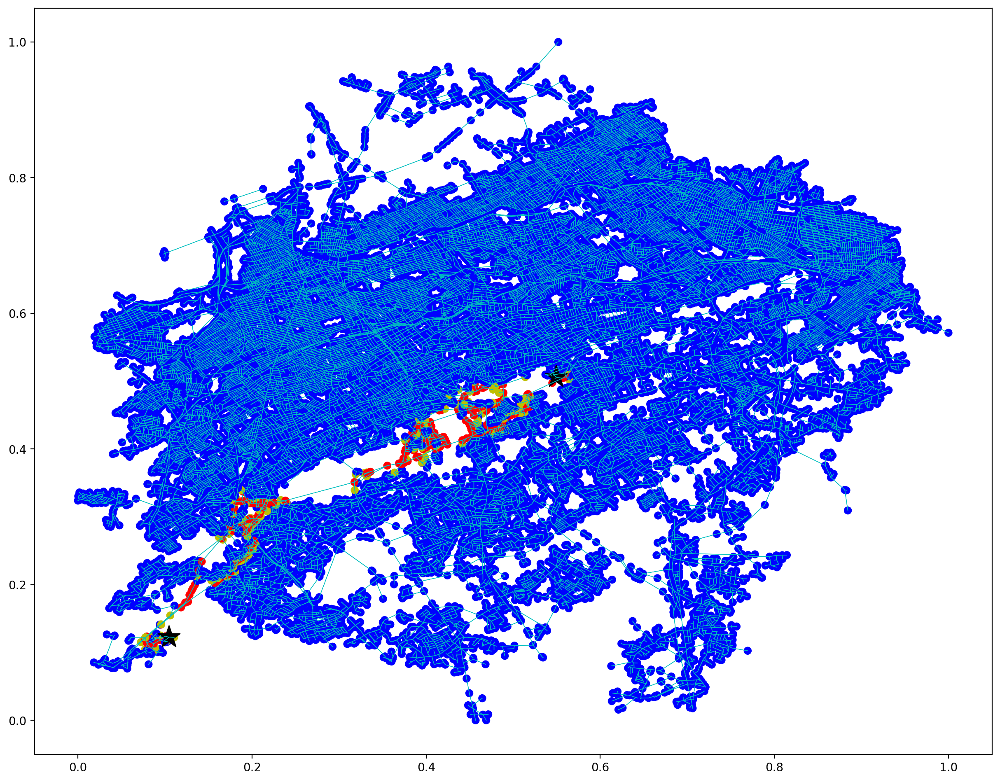

(30000,)
[0.80630257 0.81181025 0.81934833 ... 0.15707399 0.15330668 0.14798892]
[0.7989385  0.80315047 0.80748    ... 0.40253819 0.39945675 0.3972282 ]
83550
83550
There are 83550 edges in the graph. 
2  nodes 3289 27025
1000 -------------
2000 -------------
3000 -------------
4000 -------------
5000 -------------
6000 -------------
7000 -------------
8000 -------------
9000 -------------
10000 -------------
11000 -------------
12000 -------------
13000 -------------
14000 -------------
15000 -------------
16000 -------------
17000 -------------
18000 -------------
19000 -------------
20000 -------------
21000 -------------
22000 -------------
23000 -------------
24000 -------------
25000 -------------
26000 -------------
27000 -------------
28000 -------------
29000 -------------
30000 -------------
31000 -------------
32000 -------------
33000 -------------
34000 -------------
35000 -------------
36000 -------------
37000 -------------
38000 -------------
39000 -------------
40000 -

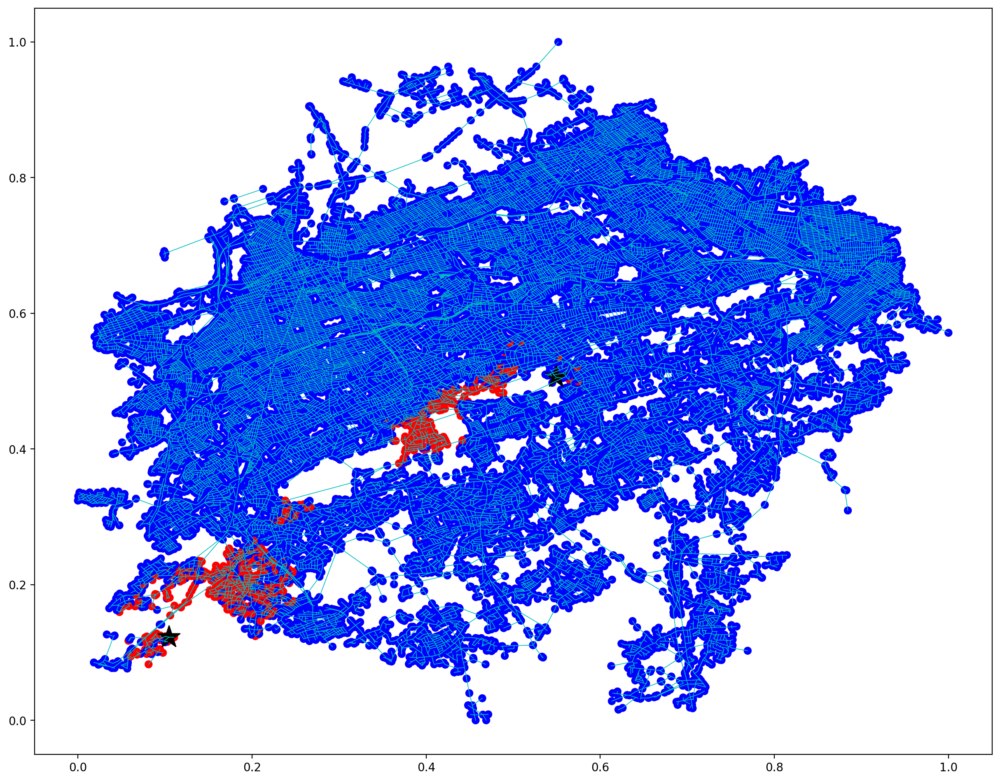

21: 643 / 718=0.8955431754874652 ===== overall:606.5 / 367.40625 in 31.88890528678894 second
22: 636 / 898=0.7082405345211581 ===== overall:606.5 / 367.40625 in 31.88890528678894 second
23: 735 / 201=3.656716417910448 ===== overall:606.5 / 367.40625 in 31.88890528678894 second
24: 440 / 215=2.046511627906977 ===== overall:606.5 / 367.40625 in 31.88890528678894 second
25: 1003 / 740=1.3554054054054054 ===== overall:606.5 / 367.40625 in 31.88890528678894 second
26: 747 / 915=0.8163934426229508 ===== overall:606.5 / 367.40625 in 31.88890528678894 second
27: 186 / 198=0.9393939393939394 ===== overall:606.5 / 367.40625 in 31.88890528678894 second
28: 2225 / 1356=1.6408554572271385 ===== overall:606.5 / 367.40625 in 31.88890528678894 second
29: 1811 / 677=2.675036927621861 ===== overall:606.5 / 367.40625 in 31.88890528678894 second
30: 483 / 1107=0.4363143631436314 ===== overall:606.5 / 367.40625 in 31.88890528678894 second
31: 797 / 529=1.5066162570888468 ===== overall:606.5 / 367.40625 in 

In [22]:
batch_num = 1
show_i = 20
n = org_num_node
test_data = None
grahp_size = n

for index, data in enumerate(org_test_loader):
#     print(index)
    if index == batch_num:
      test_data = data
      break

print(test_data)

start_time = time.time()
val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, logits = test(test_data)
end_time = time.time()
print("Val:{:.4f}({:.5f}+{:.5f})[{:.5f} - {:.5f}], running time each epoch:{:.2f}".format(
            val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, (end_time - start_time)))

for i in range(32):
    predictions = np.argmax(logits[i*n:(i+1)*n, :].cpu().detach().numpy(), axis=1)
    data_y = data.y.cpu().detach().numpy()[i*n:(i+1)*n]
    pre_n_i = (predictions == 1).sum() + (predictions == 2).sum()
    total_n_i = (data_y == 1).sum()+(data_y == 2).sum()
    ratio = pre_n_i/total_n_i
    print("{}: {} / {}={} ===== overall:{} / {} in {} second".format(i, pre_n_i, total_n_i, ratio, test_p_n, test_n, end_time - start_time))

    if i == show_i:
        draw_graph_with_DataObj(org_graph, data_y, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item(),size=(15, 12), dpi=200)
        draw_graph_with_DataObj(org_graph, predictions, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item(),size=(15, 12), dpi=200)

Batch(x=[960000, 2], edge_index=[2, 2673600], edge_attr=[2673600, 3], y=[960000], src_node_idx=[32], dest_node_idx=[32], batch=[960000], ptr=[33])
Batch(x=[960000, 2], edge_index=[2, 2673600], edge_attr=[2673600, 3], y=[960000], src_node_idx=[32], dest_node_idx=[32], batch=[960000], ptr=[33])
30000
Linear(in_features=2, out_features=256, bias=True) SAGEConv(256, 256) SAGEConv(256, 256)
torch.Size([960000, 256]) torch.Size([2, 2673600])
32 11757 19218
Val:0.0853(0.08529+0.00000)[600.56250 - 367.40625], running time each epoch:25.99
0: 244 / 808=0.30198019801980197 ===== overall:600.5625 / 367.40625 in 25.99383521080017 second
1: 643 / 620=1.0370967741935484 ===== overall:600.5625 / 367.40625 in 25.99383521080017 second
2: 1052 / 980=1.073469387755102 ===== overall:600.5625 / 367.40625 in 25.99383521080017 second
3: 566 / 622=0.909967845659164 ===== overall:600.5625 / 367.40625 in 25.99383521080017 second
4: 432 / 685=0.6306569343065693 ===== overall:600.5625 / 367.40625 in 25.9938352108

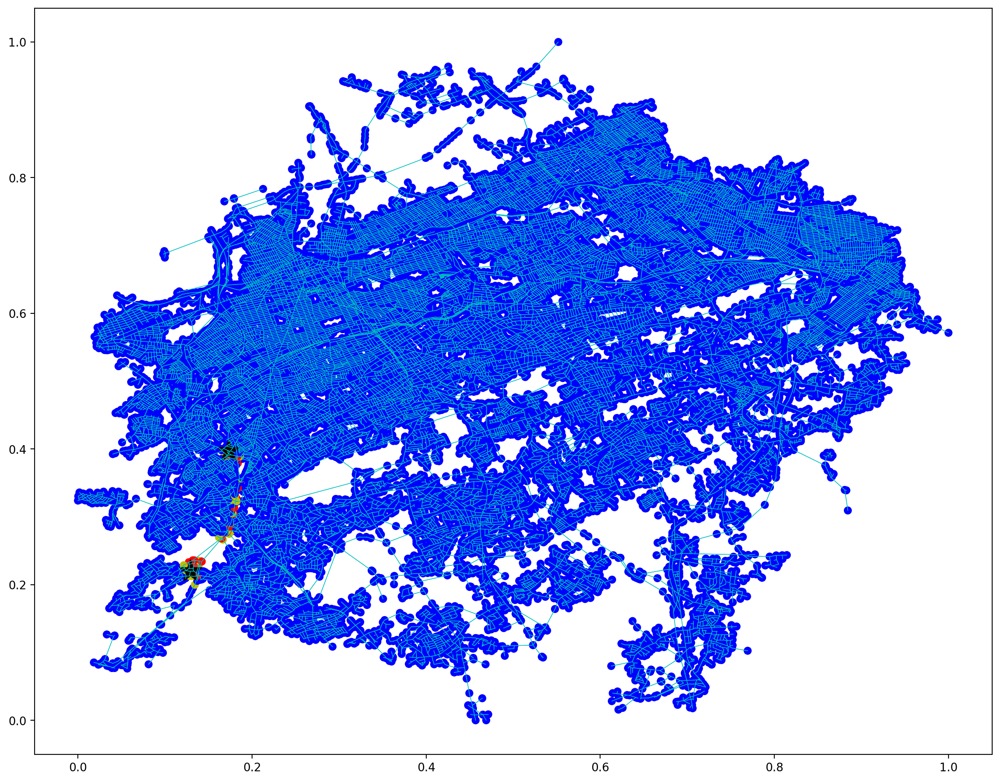

(30000,)
[0.80630257 0.81181025 0.81934833 ... 0.15707399 0.15330668 0.14798892]
[0.7989385  0.80315047 0.80748    ... 0.40253819 0.39945675 0.3972282 ]
83550
83550
There are 83550 edges in the graph. 
2  nodes 28277 27154
1000 -------------
2000 -------------
3000 -------------
4000 -------------
5000 -------------
6000 -------------
7000 -------------
8000 -------------
9000 -------------
10000 -------------
11000 -------------
12000 -------------
13000 -------------
14000 -------------
15000 -------------
16000 -------------
17000 -------------
18000 -------------
19000 -------------
20000 -------------
21000 -------------
22000 -------------
23000 -------------
24000 -------------
25000 -------------
26000 -------------
27000 -------------
28000 -------------
29000 -------------
30000 -------------
31000 -------------
32000 -------------
33000 -------------
34000 -------------
35000 -------------
36000 -------------
37000 -------------
38000 -------------
39000 -------------
40000 

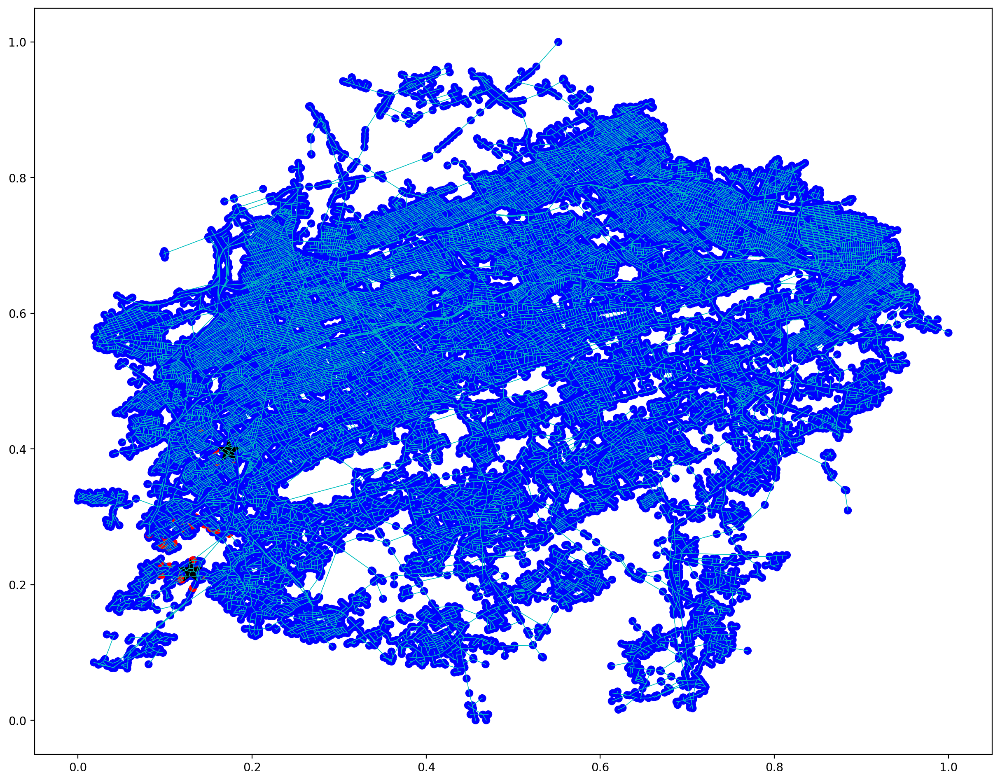

11: 1095 / 1469=0.7454050374404356 ===== overall:600.5625 / 367.40625 in 25.99383521080017 second
12: 347 / 279=1.2437275985663083 ===== overall:600.5625 / 367.40625 in 25.99383521080017 second
13: 605 / 437=1.3844393592677346 ===== overall:600.5625 / 367.40625 in 25.99383521080017 second
14: 299 / 731=0.40902872777017785 ===== overall:600.5625 / 367.40625 in 25.99383521080017 second
15: 875 / 970=0.9020618556701031 ===== overall:600.5625 / 367.40625 in 25.99383521080017 second
16: 86 / 104=0.8269230769230769 ===== overall:600.5625 / 367.40625 in 25.99383521080017 second
17: 321 / 117=2.7435897435897436 ===== overall:600.5625 / 367.40625 in 25.99383521080017 second
18: 274 / 685=0.4 ===== overall:600.5625 / 367.40625 in 25.99383521080017 second
19: 481 / 474=1.0147679324894514 ===== overall:600.5625 / 367.40625 in 25.99383521080017 second
20: 704 / 502=1.402390438247012 ===== overall:600.5625 / 367.40625 in 25.99383521080017 second
21: 621 / 718=0.8649025069637883 ===== overall:600.562

In [23]:
batch_num = 1
show_i = 10
n = org_num_node
test_data = None
grahp_size = n

for index, data in enumerate(org_test_loader):
#     print(index)
    if index == batch_num:
      test_data = data
      break

print(test_data)

start_time = time.time()
val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, logits = test(test_data)
end_time = time.time()
print("Val:{:.4f}({:.5f}+{:.5f})[{:.5f} - {:.5f}], running time each epoch:{:.2f}".format(
            val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, (end_time - start_time)))

for i in range(32):
    predictions = np.argmax(logits[i*n:(i+1)*n, :].cpu().detach().numpy(), axis=1)
    data_y = data.y.cpu().detach().numpy()[i*n:(i+1)*n]
    pre_n_i = (predictions == 1).sum() + (predictions == 2).sum()
    total_n_i = (data_y == 1).sum()+(data_y == 2).sum()
    ratio = pre_n_i/total_n_i
    print("{}: {} / {}={} ===== overall:{} / {} in {} second".format(i, pre_n_i, total_n_i, ratio, test_p_n, test_n, end_time - start_time))

    if i == show_i:
        draw_graph_with_DataObj(org_graph, data_y, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item(),size=(15, 12), dpi=200)
        draw_graph_with_DataObj(org_graph, predictions, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item(),size=(15, 12), dpi=200)

Batch(x=[960000, 2], edge_index=[2, 2673600], edge_attr=[2673600, 3], y=[960000], src_node_idx=[32], dest_node_idx=[32], batch=[960000], ptr=[33])
Batch(x=[960000, 2], edge_index=[2, 2673600], edge_attr=[2673600, 3], y=[960000], src_node_idx=[32], dest_node_idx=[32], batch=[960000], ptr=[33])
30000
Linear(in_features=2, out_features=256, bias=True) SAGEConv(256, 256) SAGEConv(256, 256)
torch.Size([960000, 256]) torch.Size([2, 2673600])
32 14250 23410
Val:0.1060(0.10597+0.00000)[731.56250 - 445.31250], running time each epoch:40.81
0: 384 / 910=0.421978021978022 ===== overall:731.5625 / 445.3125 in 40.81147527694702 second
1: 1286 / 697=1.8450502152080344 ===== overall:731.5625 / 445.3125 in 40.81147527694702 second
2: 308 / 277=1.111913357400722 ===== overall:731.5625 / 445.3125 in 40.81147527694702 second
3: 446 / 243=1.8353909465020577 ===== overall:731.5625 / 445.3125 in 40.81147527694702 second
4: 1976 / 886=2.230248306997743 ===== overall:731.5625 / 445.3125 in 40.81147527694702 s

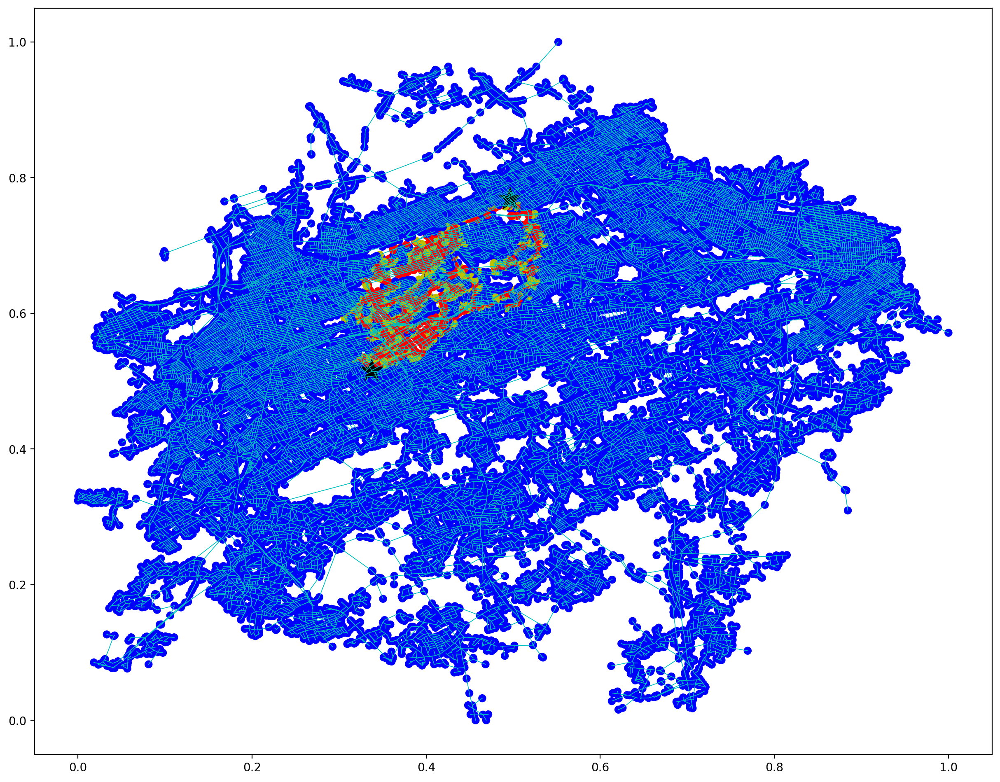

(30000,)
[0.80630257 0.81181025 0.81934833 ... 0.15707399 0.15330668 0.14798892]
[0.7989385  0.80315047 0.80748    ... 0.40253819 0.39945675 0.3972282 ]
83550
83550
There are 83550 edges in the graph. 
2  nodes 2420 2344
1000 -------------
2000 -------------
3000 -------------
4000 -------------
5000 -------------
6000 -------------
7000 -------------
8000 -------------
9000 -------------
10000 -------------
11000 -------------
12000 -------------
13000 -------------
14000 -------------
15000 -------------
16000 -------------
17000 -------------
18000 -------------
19000 -------------
20000 -------------
21000 -------------
22000 -------------
23000 -------------
24000 -------------
25000 -------------
26000 -------------
27000 -------------
28000 -------------
29000 -------------
30000 -------------
31000 -------------
32000 -------------
33000 -------------
34000 -------------
35000 -------------
36000 -------------
37000 -------------
38000 -------------
39000 -------------
40000 --

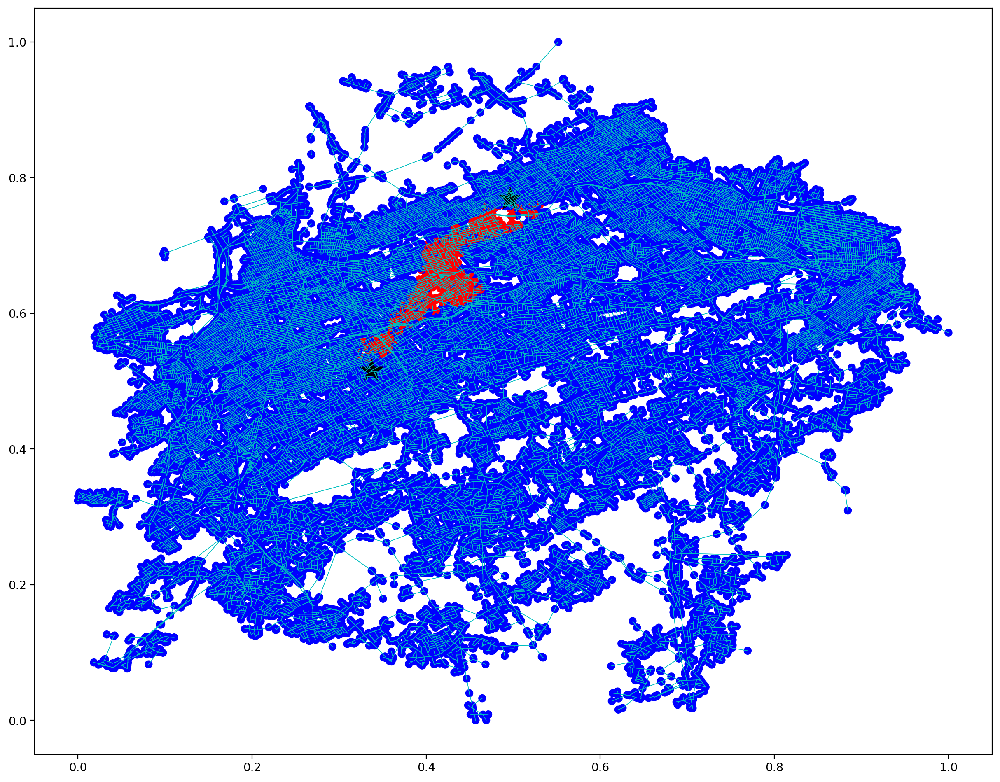

25: 1376 / 1029=1.337220602526725 ===== overall:731.5625 / 445.3125 in 40.81147527694702 second
26: 310 / 479=0.6471816283924844 ===== overall:731.5625 / 445.3125 in 40.81147527694702 second
27: 571 / 572=0.9982517482517482 ===== overall:731.5625 / 445.3125 in 40.81147527694702 second
28: 841 / 1438=0.5848400556328234 ===== overall:731.5625 / 445.3125 in 40.81147527694702 second
29: 44 / 416=0.10576923076923077 ===== overall:731.5625 / 445.3125 in 40.81147527694702 second
30: 1487 / 941=1.5802337938363442 ===== overall:731.5625 / 445.3125 in 40.81147527694702 second
31: 1022 / 890=1.148314606741573 ===== overall:731.5625 / 445.3125 in 40.81147527694702 second


In [24]:
batch_num = 0
show_i = 24
n = org_num_node
test_data = None
grahp_size = n

for index, data in enumerate(org_test_loader):
#     print(index)
    if index == batch_num:
      test_data = data
      break

print(test_data)

start_time = time.time()
val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, logits = test(test_data)
end_time = time.time()
print("Val:{:.4f}({:.5f}+{:.5f})[{:.5f} - {:.5f}], running time each epoch:{:.2f}".format(
            val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, (end_time - start_time)))

for i in range(32):
    predictions = np.argmax(logits[i*n:(i+1)*n, :].cpu().detach().numpy(), axis=1)
    data_y = data.y.cpu().detach().numpy()[i*n:(i+1)*n]
    pre_n_i = (predictions == 1).sum() + (predictions == 2).sum()
    total_n_i = (data_y == 1).sum()+(data_y == 2).sum()
    ratio = pre_n_i/total_n_i
    print("{}: {} / {}={} ===== overall:{} / {} in {} second".format(i, pre_n_i, total_n_i, ratio, test_p_n, test_n, end_time - start_time))

    if i == show_i:
        draw_graph_with_DataObj(org_graph, data_y, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item(),size=(15, 12), dpi=200)
        draw_graph_with_DataObj(org_graph, predictions, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item(),size=(15, 12), dpi=200)

Batch(x=[960000, 2], edge_index=[2, 2673600], edge_attr=[2673600, 3], y=[960000], src_node_idx=[32], dest_node_idx=[32], batch=[960000], ptr=[33])
Batch(x=[960000, 2], edge_index=[2, 2673600], edge_attr=[2673600, 3], y=[960000], src_node_idx=[32], dest_node_idx=[32], batch=[960000], ptr=[33])
30000
Linear(in_features=2, out_features=256, bias=True) SAGEConv(256, 256) SAGEConv(256, 256)
torch.Size([960000, 256]) torch.Size([2, 2673600])
32 14250 23335
Val:0.1058(0.10577+0.00000)[729.21875 - 445.31250], running time each epoch:42.87
0: 408 / 910=0.44835164835164837 ===== overall:729.21875 / 445.3125 in 42.86864495277405 second
1: 1259 / 697=1.8063127690100431 ===== overall:729.21875 / 445.3125 in 42.86864495277405 second
2: 294 / 277=1.0613718411552346 ===== overall:729.21875 / 445.3125 in 42.86864495277405 second
3: 444 / 243=1.8271604938271604 ===== overall:729.21875 / 445.3125 in 42.86864495277405 second
4: 1964 / 886=2.216704288939052 ===== overall:729.21875 / 445.3125 in 42.86864495

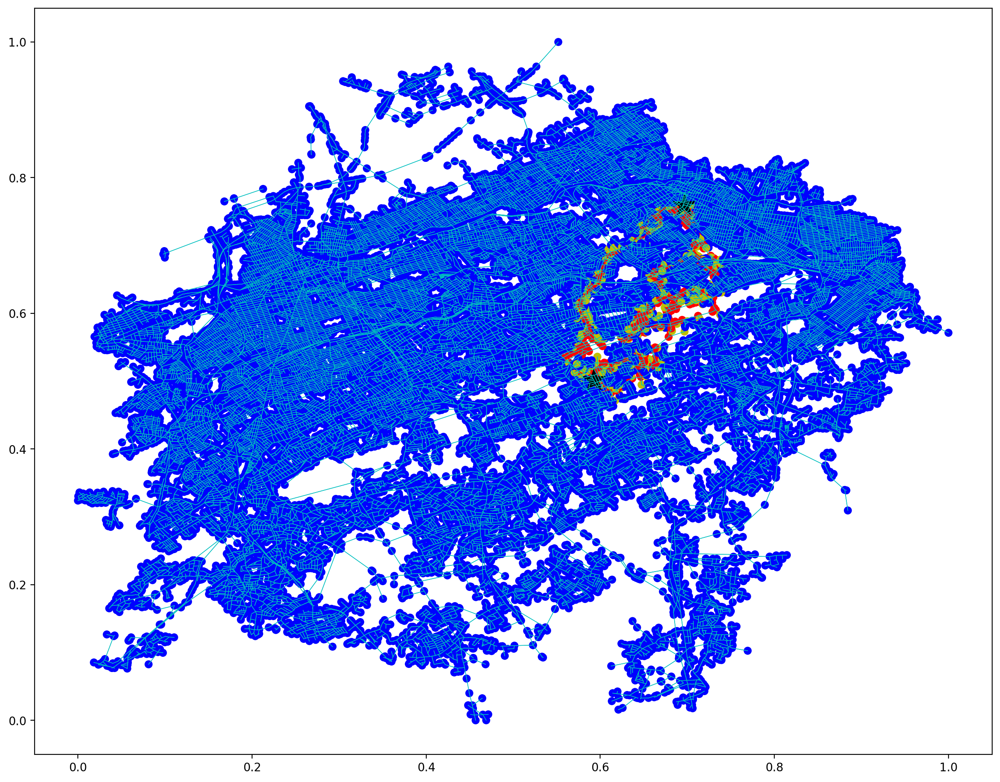

(30000,)
[0.80630257 0.81181025 0.81934833 ... 0.15707399 0.15330668 0.14798892]
[0.7989385  0.80315047 0.80748    ... 0.40253819 0.39945675 0.3972282 ]
83550
83550
There are 83550 edges in the graph. 
2  nodes 3110 21378
1000 -------------
2000 -------------
3000 -------------
4000 -------------
5000 -------------
6000 -------------
7000 -------------
8000 -------------
9000 -------------
10000 -------------
11000 -------------
12000 -------------
13000 -------------
14000 -------------
15000 -------------
16000 -------------
17000 -------------
18000 -------------
19000 -------------
20000 -------------
21000 -------------
22000 -------------
23000 -------------
24000 -------------
25000 -------------
26000 -------------
27000 -------------
28000 -------------
29000 -------------
30000 -------------
31000 -------------
32000 -------------
33000 -------------
34000 -------------
35000 -------------
36000 -------------
37000 -------------
38000 -------------
39000 -------------
40000 -

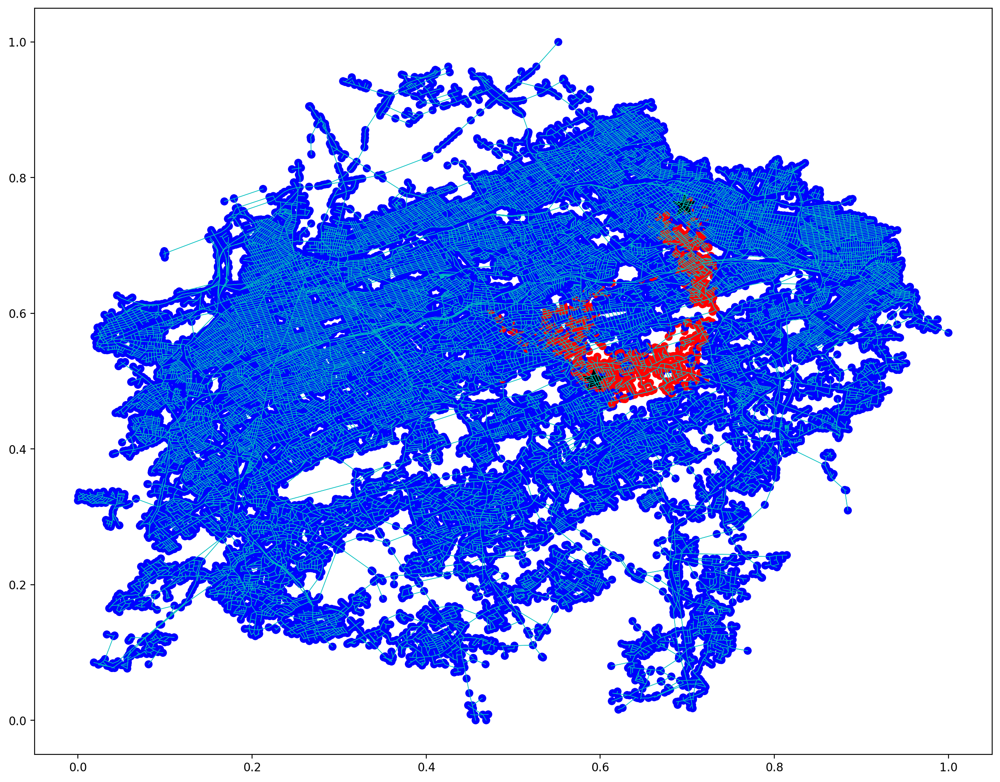

In [25]:
batch_num = 0
show_i = 31
n = org_num_node
test_data = None
grahp_size = n

for index, data in enumerate(org_test_loader):
#     print(index)
    if index == batch_num:
      test_data = data
      break

print(test_data)

start_time = time.time()
val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, logits = test(test_data)
end_time = time.time()
print("Val:{:.4f}({:.5f}+{:.5f})[{:.5f} - {:.5f}], running time each epoch:{:.2f}".format(
            val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, (end_time - start_time)))

for i in range(32):
    predictions = np.argmax(logits[i*n:(i+1)*n, :].cpu().detach().numpy(), axis=1)
    data_y = data.y.cpu().detach().numpy()[i*n:(i+1)*n]
    pre_n_i = (predictions == 1).sum() + (predictions == 2).sum()
    total_n_i = (data_y == 1).sum()+(data_y == 2).sum()
    ratio = pre_n_i/total_n_i
    print("{}: {} / {}={} ===== overall:{} / {} in {} second".format(i, pre_n_i, total_n_i, ratio, test_p_n, test_n, end_time - start_time))

    if i == show_i:
        draw_graph_with_DataObj(org_graph, data_y, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item(),size=(15, 12), dpi=200)
        draw_graph_with_DataObj(org_graph, predictions, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item(),size=(15, 12), dpi=200)

In [32]:
batch_num = 5
show_i = 10
n = org_num_node
test_data = None
grahp_size = n

for index, data in enumerate(org_test_loader):
#     print(index)
    if index == batch_num:
      test_data = data
      break

print(test_data)

start_time = time.time()
val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, logits = test(test_data)
end_time = time.time()
print("Val:{:.4f}({:.5f}+{:.5f})[{:.5f} - {:.5f}], running time each epoch:{:.2f}".format(
            val_auc, test_nll_loss, test_conn_loss, test_p_n, test_n, (end_time - start_time)))

for i in range(32):
    predictions = np.argmax(logits[i*n:(i+1)*n, :].cpu().detach().numpy(), axis=1)
    data_y = data.y.cpu().detach().numpy()[i*n:(i+1)*n]
    pre_n_i = (predictions == 1).sum() + (predictions == 2).sum()
    total_n_i = (data_y == 1).sum()+(data_y == 2).sum()
    ratio = pre_n_i/total_n_i
    print("{}: {} / {}={} ===== overall:{} / {} in {} second".format(i, pre_n_i, total_n_i, ratio, test_p_n, test_n, end_time - start_time))

    if i == show_i:
        draw_graph_with_DataObj(org_graph, data_y, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item(),size=(15, 12), dpi=200)
        draw_graph_with_DataObj(org_graph, predictions, test_data.src_node_idx[i].item(), test_data.dest_node_idx[i].item(),size=(15, 12), dpi=200)

Batch(x=[960000, 2], edge_index=[2, 2673600], edge_attr=[2673600, 3], y=[960000], src_node_idx=[32], dest_node_idx=[32], batch=[960000], ptr=[33])
Batch(x=[960000, 2], edge_index=[2, 2673600], edge_attr=[2673600, 3], y=[960000], src_node_idx=[32], dest_node_idx=[32], batch=[960000], ptr=[33])
30000
Linear(in_features=2, out_features=256, bias=True) SAGEConv(256, 256) SAGEConv(256, 256)
torch.Size([960000, 256]) torch.Size([2, 2673600])


In [ ]:
import matplotlib.pyplot as plt
import networkx as nx
from torch_geometric.utils.convert import to_networkx
import numpy as np
import sys
from tqdm import tqdm

# plt.figure(figsize=(20, 20))
# # print(graph.edge_attr.list())
# print(type(predictions))
# print(np.where(predictions==1))
# print(np.where(predictions==1)[0].tolist())
i=show_i
n_graph = to_networkx(org_graph, to_undirected=True, remove_self_loops=False)
src = test_data.src_node_idx[i].item()
dest = test_data.dest_node_idx[i].item()
target_node_list = np.where(predictions == 1)[0].tolist()
print(src, dest, len(n_graph.nodes), len(target_node_list))

sub_node_set = set()
for idx, node in tqdm(enumerate(target_node_list)):
    s_path = nx.dijkstra_path(n_graph, node, src)
    d_path = nx.dijkstra_path(n_graph, node, dest)
    # print(idx, ":", node, len(s_path), len(d_path))
    sub_node_set.update(s_path)
    sub_node_set.update(d_path)
sub_node_set.add(src)
sub_node_set.add(dest)
# print(sub_node_set)

plt.figure(figsize=(20, 20))
sb = n_graph.subgraph(sub_node_set).copy()
print(nx.number_connected_components(sb))

max_x = max_y = 0
min_x = min_y = 1
n_post = {}
for idx, n in enumerate(org_graph.x):
    # print(idx, n[0].item(), n[1].item())
    if idx in sub_node_set:
        n_post[idx] = [n[0].item(), n[1].item()]

        if n[0].item() > max_x:
            max_x = n[0].item()
        if n[0].item() < min_x:
            min_x = n[0].item()

        if n[1].item() > max_y:
            max_y = n[1].item()
        if n[1].item() < min_y:
            min_y = n[1].item()


# print(n_post)
nx.draw_networkx_edges(sb, n_post, alpha=0.4)
nx.draw_networkx_nodes(sb, n_post,
                       sub_node_set,
                       node_size=10,
                       # node_color=list(p.values()),
                       cmap=plt.cm.Reds_r)
nx.draw_networkx_nodes(sb, {src: [org_graph.x[src][0].item(), org_graph.x[src][1].item()], dest: [org_graph.x[dest][0].item(),org_graph.x[dest][1].item()]},
                       [src, dest],
                       node_size=200,
                       node_shape='*',
                       node_color='r')

plt.xlim(min_x-0.1, max_x+0.1)
plt.ylim(min_y-0.1, max_y+0.1)
plt.show()



28428 3982 30000 752


680it [00:44, 15.21it/s]


KeyboardInterrupt: 

1765


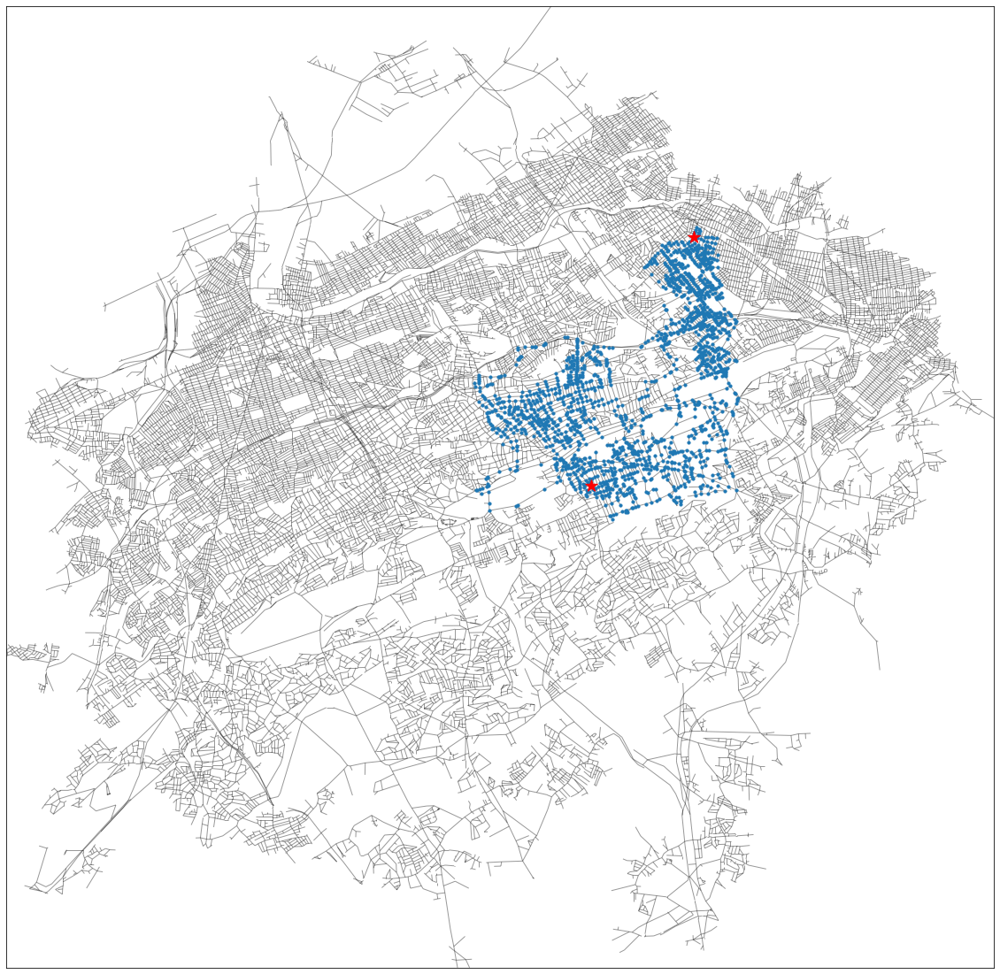

In [27]:
print(len(sub_node_set))

plt.figure(figsize=(20, 20))
pos = {}
for idx, n in enumerate(org_graph.x):
    # print(idx, n[0].item(), n[1].item())
    pos[idx] = [n[0].item(), n[1].item()]
# print(pos)

nx.draw_networkx_edges(n_graph, pos, alpha=0.4)
nx.draw_networkx_nodes(n_graph, pos,
                       sub_node_set,
                       node_size=10,
                       # node_color=list(p.values()),
                       cmap=plt.cm.Reds_r)
nx.draw_networkx_nodes(n_graph, {src: [org_graph.x[src][0].item(), org_graph.x[src][1].item()], dest: [org_graph.x[dest][0].item(),org_graph.x[dest][1].item()]},
                       [src, dest],
                       node_size=200,
                       node_color='r',
                       node_shape='*')

plt.xlim(0, 1)
plt.ylim(0, 1)
plt.show()
